In [2]:
import numpy as np
import sys
import tarfile
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()
# import tensorflow as tf
import cv2

import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# if tf.__version__ != '1.4.1':
#   raise ImportError('Please upgrade your tensorflow installation to v1.4.1!')
from utils import label_map_util
import os
from utils import visualization_utils as vis_util
# from detection_utils import parse_output_dict

In [3]:
# !python3.7 -m pip uninstall matplotlib
from matplotlib.pyplot import imshow, show    


In [4]:
# import tensorflow as tf

In [5]:
# !pip install tensorflow-gpu

In [6]:
# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT =  r"/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/frozen_inference_graph_8000_ssd_inception.pb"
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = r"/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/crackLabelMap.txt"

NUM_CLASSES = 8

In [7]:
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.io.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

In [8]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

In [9]:
def load_image_into_numpy_array(image):
    print(image.size)
    (im_width, im_height) = image.size

    return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [10]:
PATH_TO_TEST_IMAGES_DIR = r'/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images'
arr = os.listdir(PATH_TO_TEST_IMAGES_DIR)

In [11]:
def addition(n):
    
    return  os.path.join(PATH_TO_TEST_IMAGES_DIR,n)
  
# We double all numbers using map()
result = map(addition, arr)
images_test=list(result)

In [12]:
def modify(output_dict):
    num_detections = int(output_dict.pop('num_detections'))
    output_dict = {key:value[0, :num_detections] 
                 for key,value in output_dict.items()}
    output_dict['num_detections'] = num_detections

    # detection_classes should be ints.
    output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
    return output_dict

In [15]:
# for image_path in images_test[1:10]:
#         print(image_path)
#         image = Image.open(image_path)
#         plt.imshow(image)
#         show()

2022-07-06 03:08:48.360294: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-06 03:08:48.887171: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-06 03:08:48.888470: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-06 03:08:48.901203: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_002707.jpg
(720, 720)


2022-07-06 03:08:54.997317: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:354] MLIR V1 optimization pass is not enabled
2022-07-06 03:09:00.527677: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8101


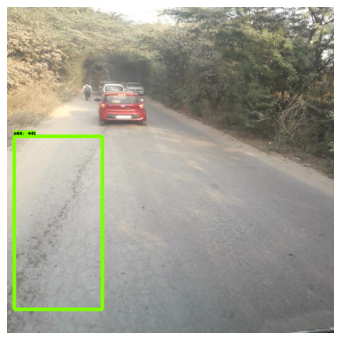

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_006263.jpg
(720, 720)


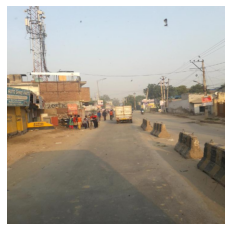

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003563.jpg
(600, 600)


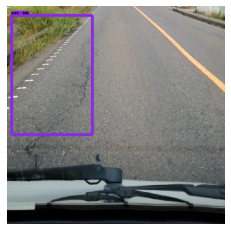

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000460.jpg
(600, 600)


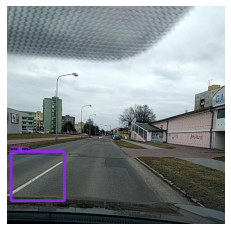

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_002648.jpg
(600, 600)


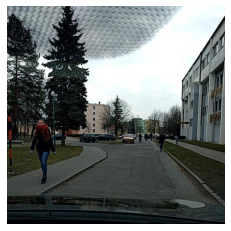

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000445.jpg
(600, 600)


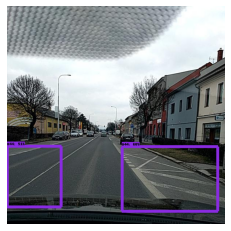

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003776.jpg
(600, 600)


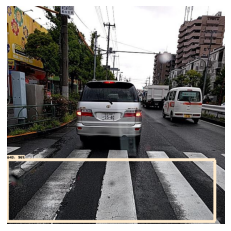

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000016.jpg
(600, 600)


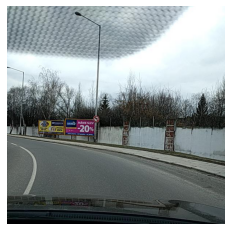

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_008561.jpg
(720, 720)


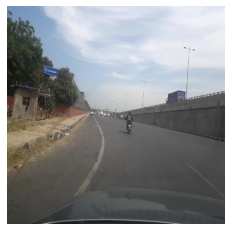

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000223.jpg
(600, 600)


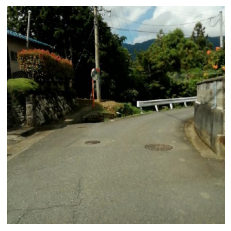

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003862.jpg
(600, 600)


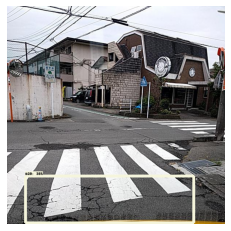

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_006666.jpg
(600, 600)


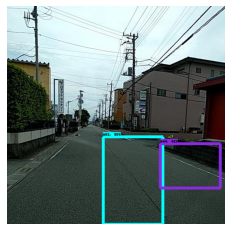

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_001091.jpg
(720, 720)


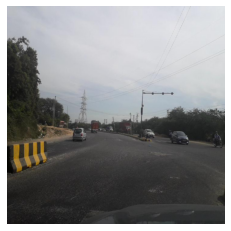

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_005928.jpg
(600, 600)


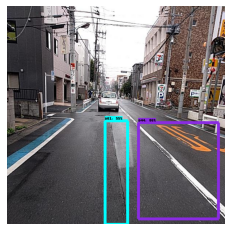

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009313.jpg
(600, 600)


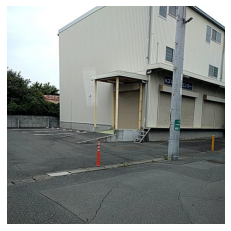

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_000009.jpg
(720, 720)


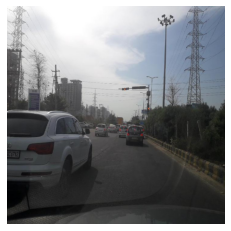

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_007847.jpg
(720, 720)


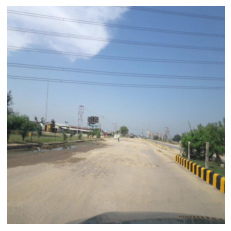

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_000573.jpg
(720, 720)


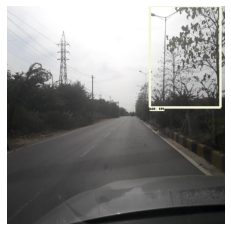

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000216.jpg
(600, 600)


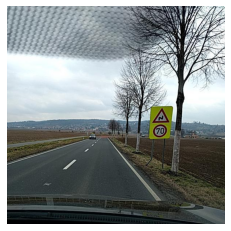

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009355.jpg
(720, 720)


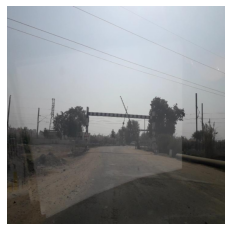

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_010066.jpg
(600, 600)


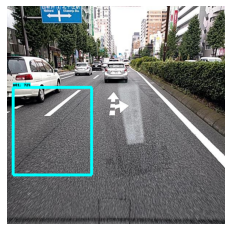

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_007060.jpg
(600, 600)


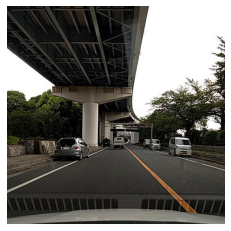

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_007541.jpg
(720, 720)


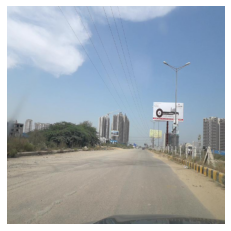

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_001769.jpg
(600, 600)


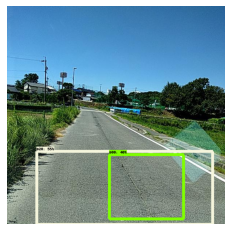

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_003777.jpg
(720, 720)


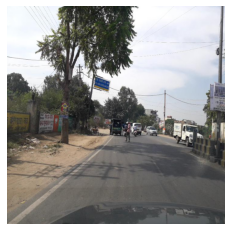

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009649.jpg
(600, 600)


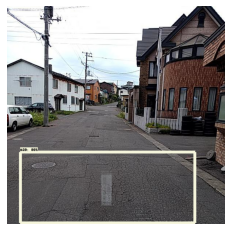

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_006926.jpg
(600, 600)


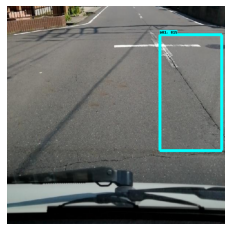

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_007162.jpg
(720, 720)


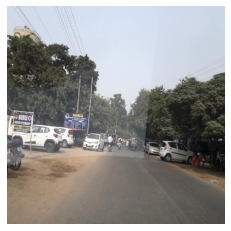

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003894.jpg
(600, 600)


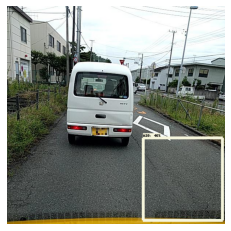

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_007908.jpg
(1024, 1024)


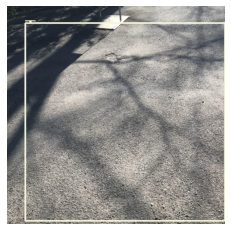

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_001379.jpg
(720, 720)


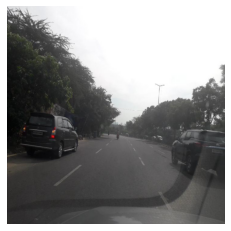

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000317.jpg
(600, 600)


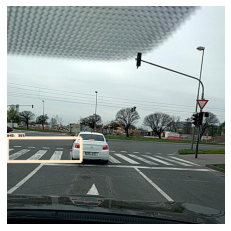

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009070.jpg
(720, 720)


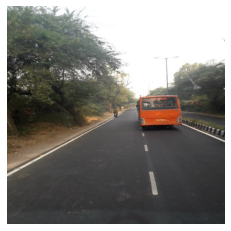

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002375.jpg
(600, 600)


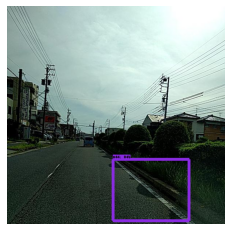

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_006383.jpg
(600, 600)


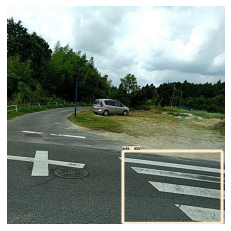

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009455.jpg
(600, 600)


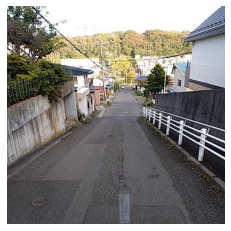

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_007008.jpg
(600, 600)


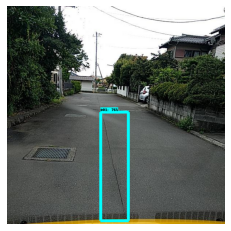

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009202.jpg
(720, 720)


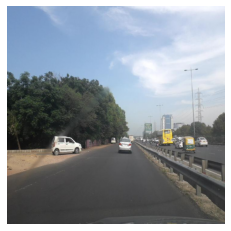

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_008122.jpg
(720, 720)


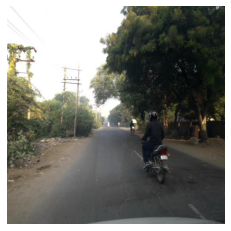

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_011587.jpg
(600, 600)


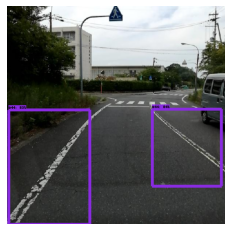

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009462.jpg
(600, 600)


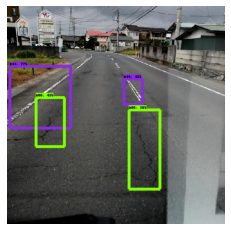

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004347.jpg
(720, 720)


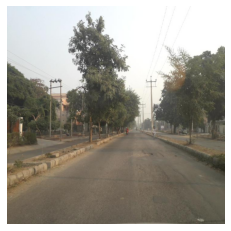

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002974.jpg
(600, 600)


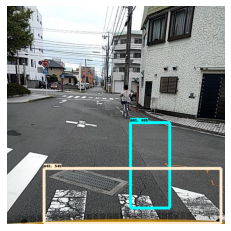

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_006455.jpg
(600, 600)


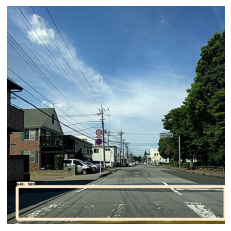

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009687.jpg
(600, 600)


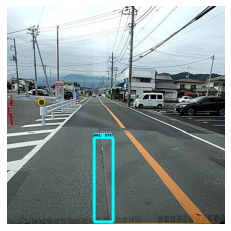

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_002837.jpg
(600, 600)


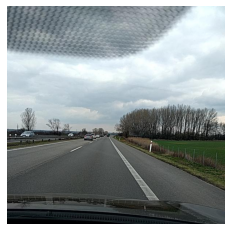

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_010673.jpg
(600, 600)


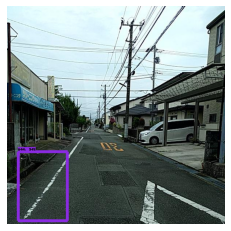

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004892.jpg
(720, 720)


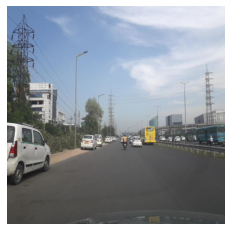

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_001562.jpg
(720, 720)


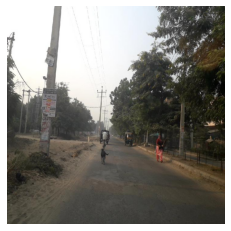

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012090.jpg
(600, 600)


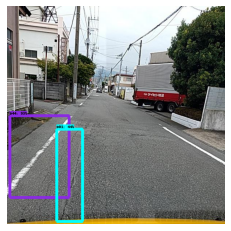

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_000641.jpg
(720, 720)


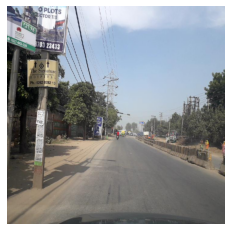

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000988.jpg
(600, 600)


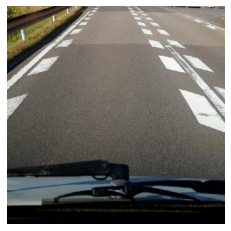

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_002377.jpg
(720, 720)


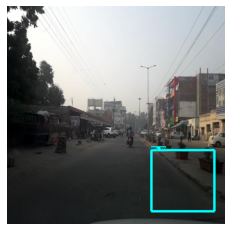

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_002620.jpg
(600, 600)


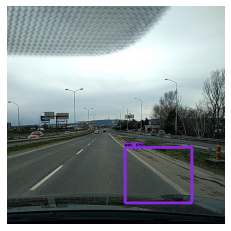

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_011921.jpg
(600, 600)


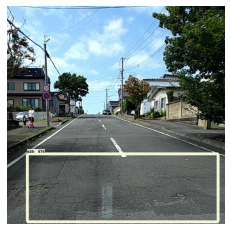

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003848.jpg
(600, 600)


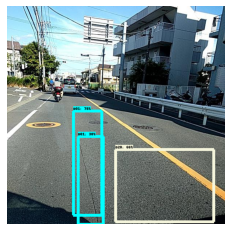

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_001209.jpg
(720, 720)


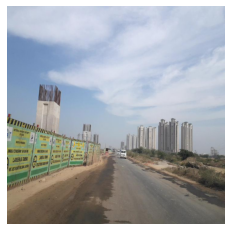

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_003799.jpg
(720, 720)


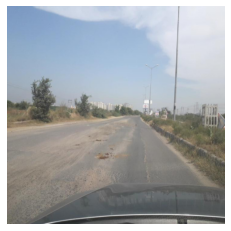

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004795.jpg
(720, 720)


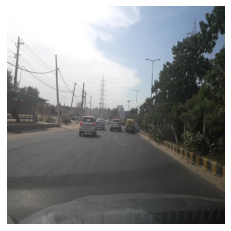

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_005321.jpg
(720, 720)


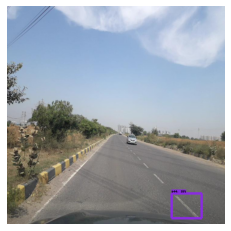

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002359.jpg
(600, 600)


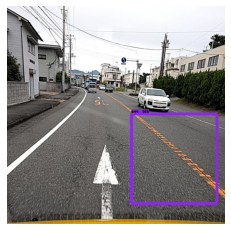

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012544.jpg
(600, 600)


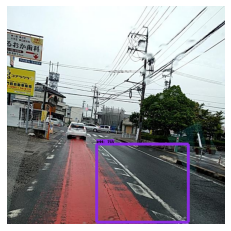

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012934.jpg
(600, 600)


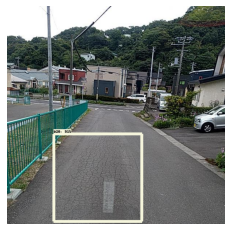

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000352.jpg
(600, 600)


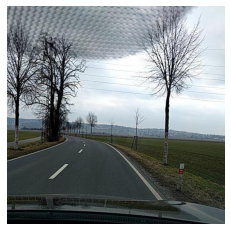

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000479.jpg
(600, 600)


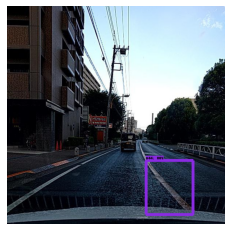

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000830.jpg
(600, 600)


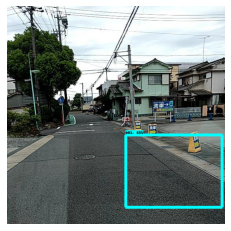

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_010271.jpg
(600, 600)


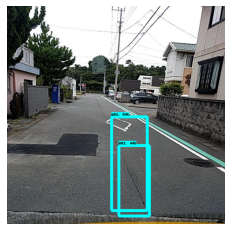

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004691.jpg
(720, 720)


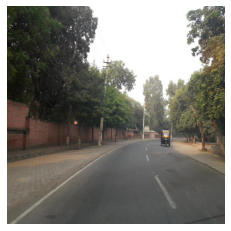

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_003210.jpg
(720, 720)


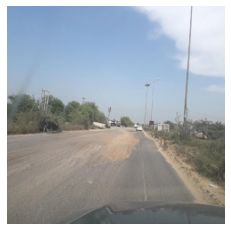

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009846.jpg
(600, 600)


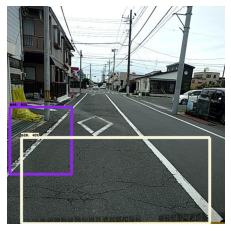

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_001894.jpg
(600, 600)


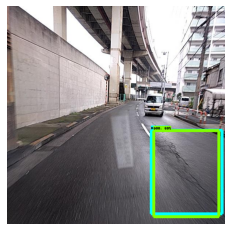

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_011116.jpg
(600, 600)


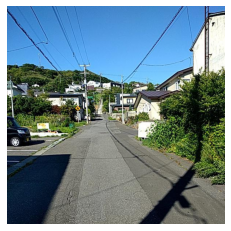

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_000479.jpg
(720, 720)


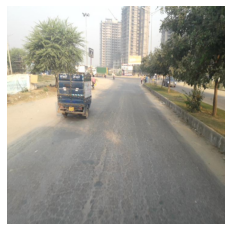

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000595.jpg
(600, 600)


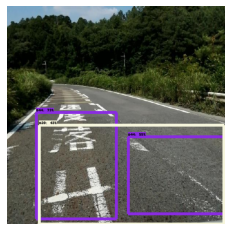

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000359.jpg
(600, 600)


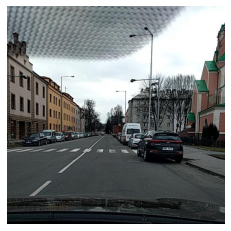

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000141.jpg
(600, 600)


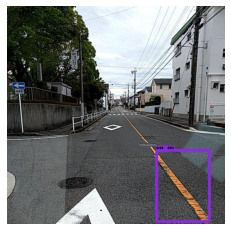

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_008980.jpg
(600, 600)


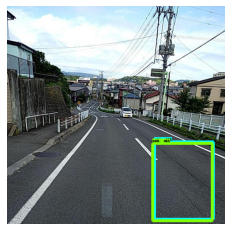

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004573.jpg
(720, 720)


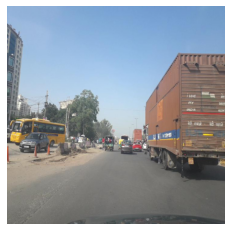

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_006855.jpg
(600, 600)


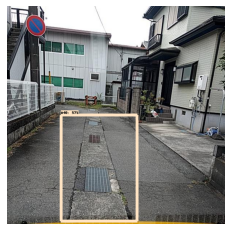

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_003136.jpg
(600, 600)


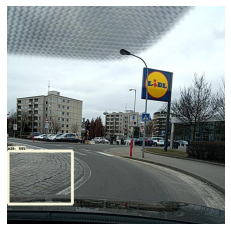

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_006118.jpg
(720, 720)


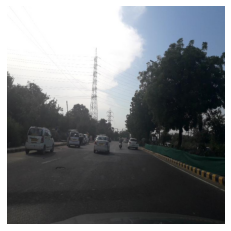

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_003451.jpg
(600, 600)


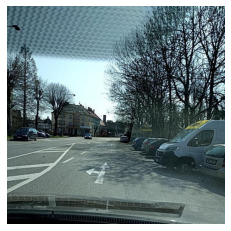

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012655.jpg
(600, 600)


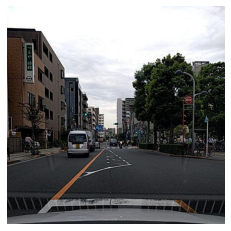

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_006439.jpg
(720, 720)


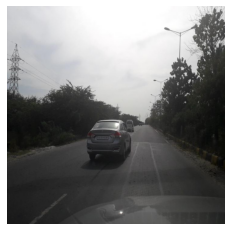

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009721.jpg
(720, 720)


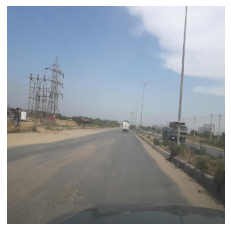

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_005133.jpg
(600, 600)


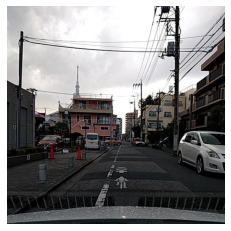

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_005372.jpg
(600, 600)


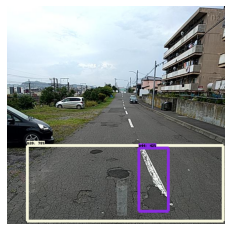

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002573.jpg
(600, 600)


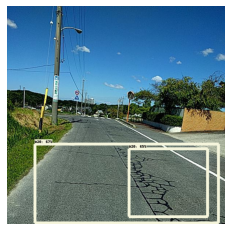

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004970.jpg
(720, 720)


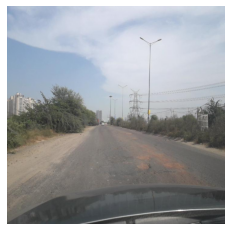

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012519.jpg
(600, 600)


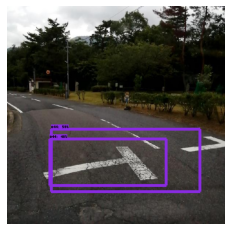

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_001688.jpg
(720, 720)


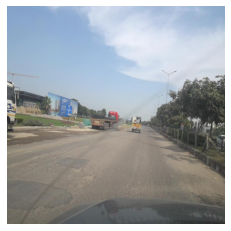

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_007125.jpg
(600, 600)


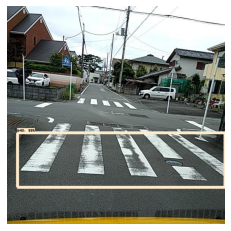

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_001828.jpg
(600, 600)


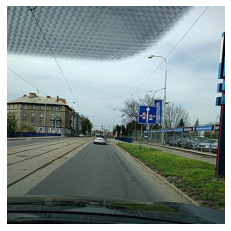

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_006190.jpg
(720, 720)


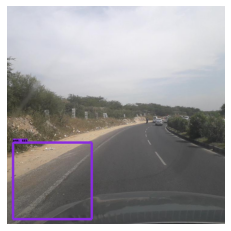

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_008456.jpg
(600, 600)


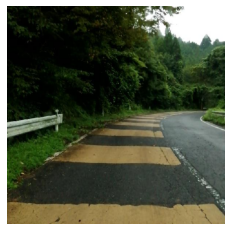

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_006210.jpg
(600, 600)


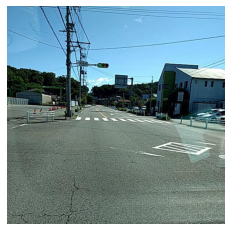

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012412.jpg
(600, 600)


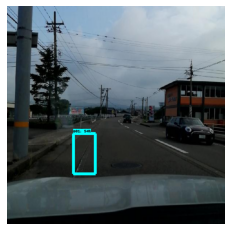

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004068.jpg
(720, 720)


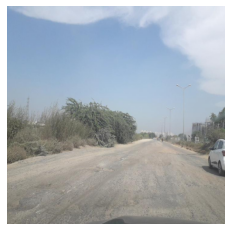

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000542.jpg
(600, 600)


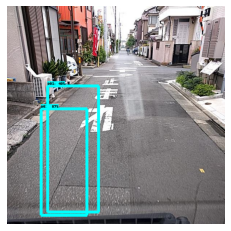

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000678.jpg
(600, 600)


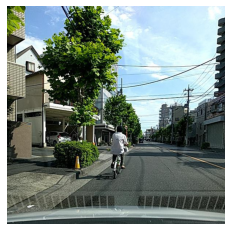

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_006757.jpg
(720, 720)


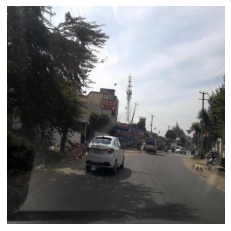

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002376.jpg
(600, 600)


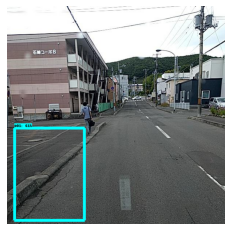

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_002053.jpg
(720, 720)


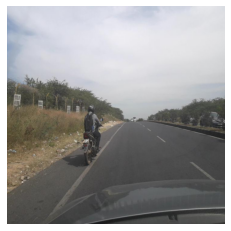

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_005132.jpg
(600, 600)


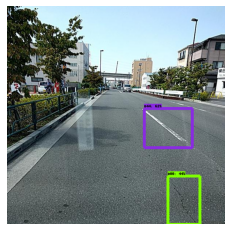

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_007321.jpg
(600, 600)


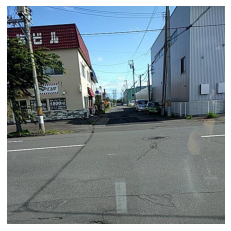

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009739.jpg
(600, 600)


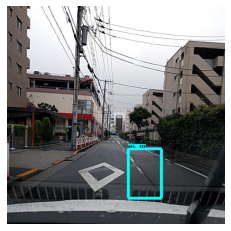

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_000211.jpg
(720, 720)


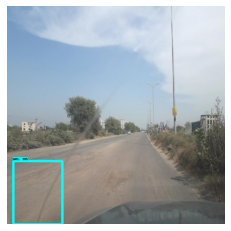

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_003625.jpg
(720, 720)


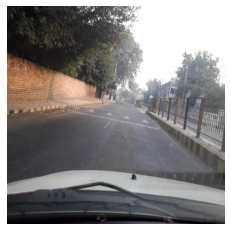

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002893.jpg
(600, 600)


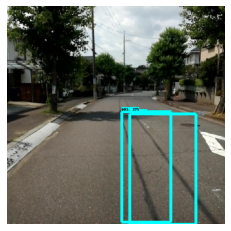

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_005755.jpg
(600, 600)


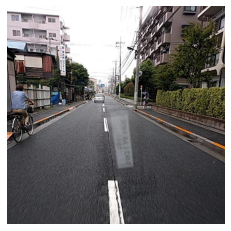

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009581.jpg
(600, 600)


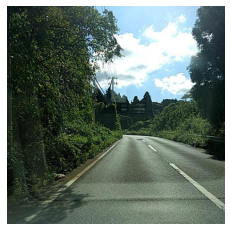

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_010453.jpg
(600, 600)


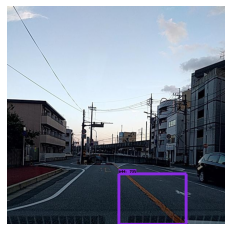

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_005485.jpg
(600, 600)


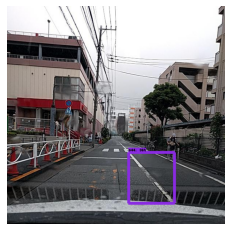

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_001170.jpg
(600, 600)


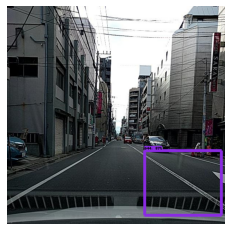

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_008373.jpg
(720, 720)


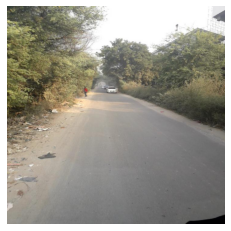

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_007597.jpg
(600, 600)


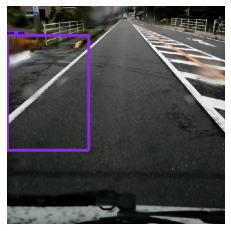

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_003295.jpg
(600, 600)


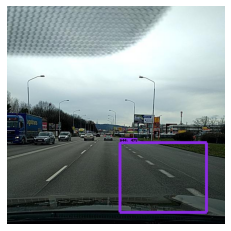

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_002414.jpg
(600, 600)


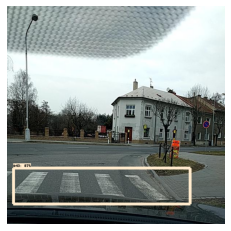

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_006792.jpg
(720, 720)


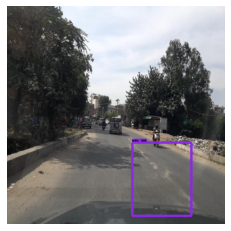

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_005462.jpg
(720, 720)


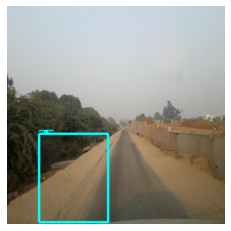

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_007969.jpg
(720, 720)


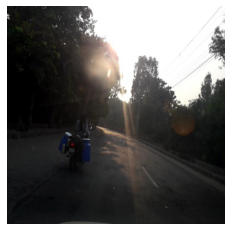

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002455.jpg
(600, 600)


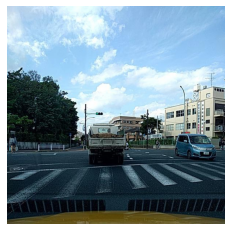

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_011667.jpg
(600, 600)


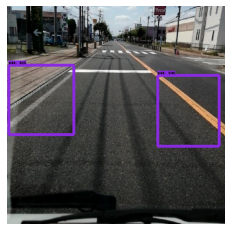

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_006783.jpg
(600, 600)


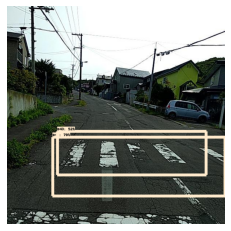

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_008482.jpg
(720, 720)


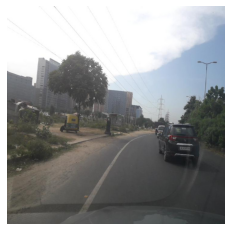

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012227.jpg
(600, 600)


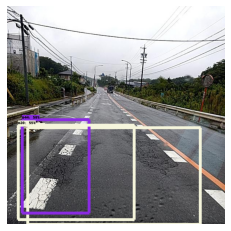

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_007510.jpg
(720, 720)


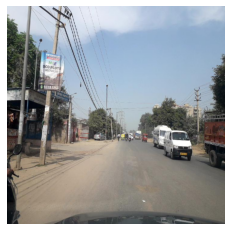

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004145.jpg
(720, 720)


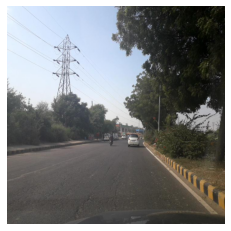

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_007353.jpg
(600, 600)


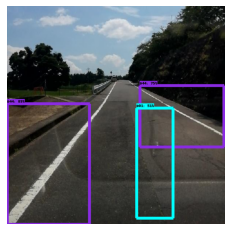

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012018.jpg
(600, 600)


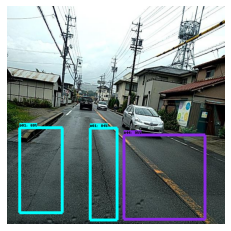

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_001309.jpg
(600, 600)


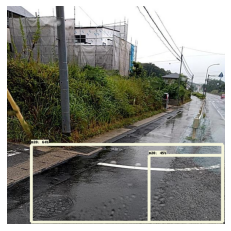

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009135.jpg
(720, 720)


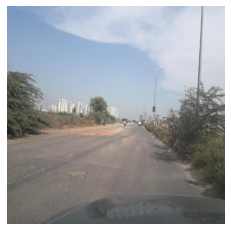

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_011946.jpg
(600, 600)


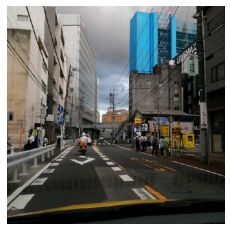

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_002558.jpg
(600, 600)


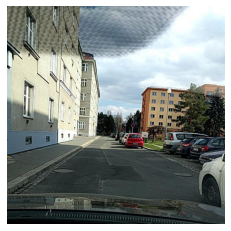

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_000953.jpg
(720, 720)


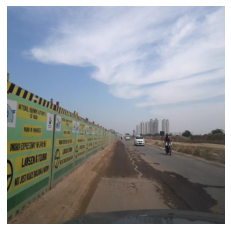

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003636.jpg
(600, 600)


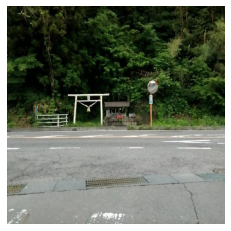

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_003487.jpg
(720, 720)


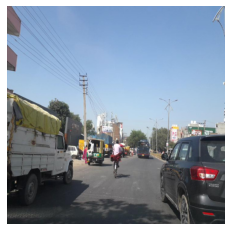

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_011811.jpg
(600, 600)


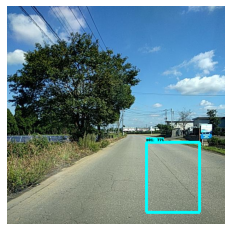

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_003404.jpg
(600, 600)


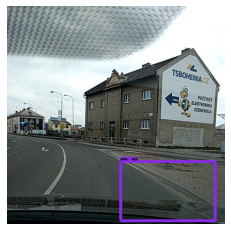

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009286.jpg
(720, 720)


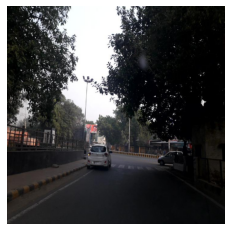

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_001458.jpg
(600, 600)


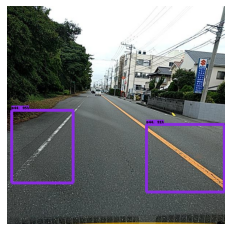

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_006134.jpg
(720, 720)


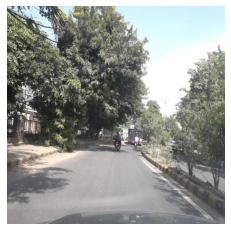

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000210.jpg
(600, 600)


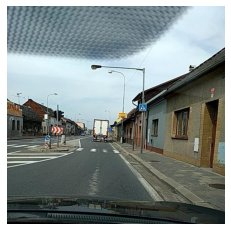

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003173.jpg
(600, 600)


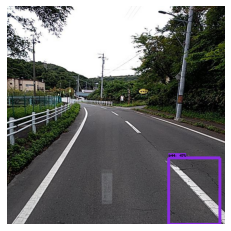

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004333.jpg
(720, 720)


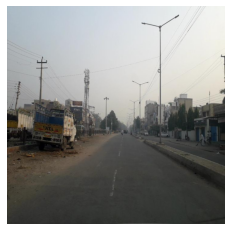

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_005763.jpg
(720, 720)


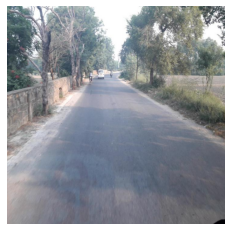

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009495.jpg
(600, 600)


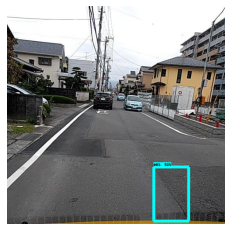

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009361.jpg
(720, 720)


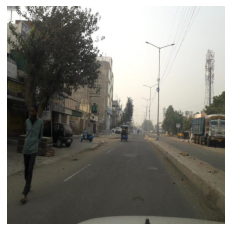

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_001906.jpg
(600, 600)


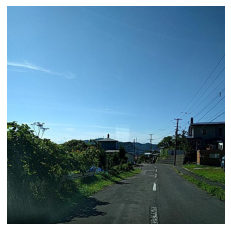

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004945.jpg
(720, 720)


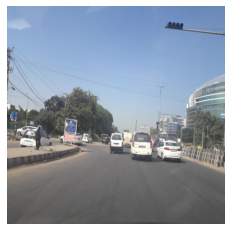

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_001376.jpg
(600, 600)


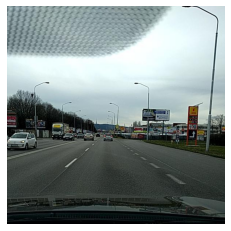

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_006257.jpg
(600, 600)


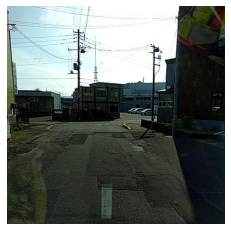

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_003559.jpg
(720, 720)


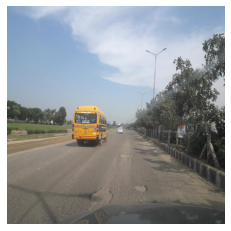

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_003607.jpg
(720, 720)


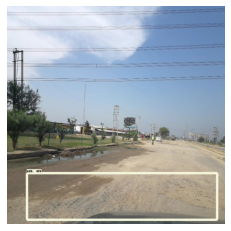

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_007178.jpg
(600, 600)


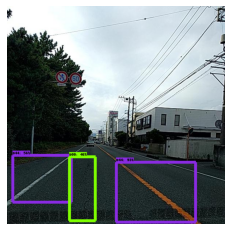

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009473.jpg
(720, 720)


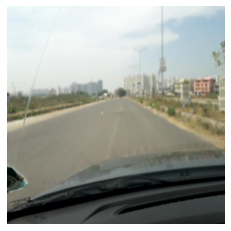

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000753.jpg
(600, 600)


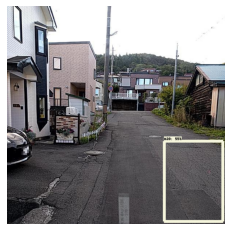

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_003991.jpg
(720, 720)


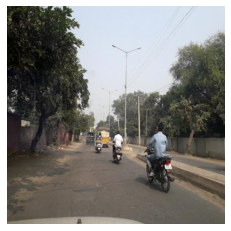

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012700.jpg
(600, 600)


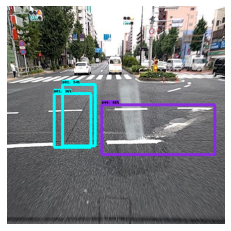

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_008474.jpg
(600, 600)


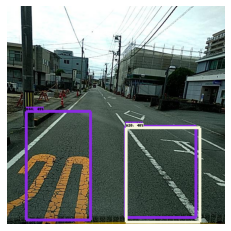

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_008147.jpg
(600, 600)


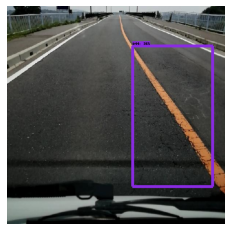

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002791.jpg
(600, 600)


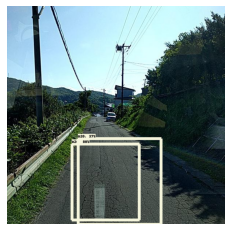

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009816.jpg
(600, 600)


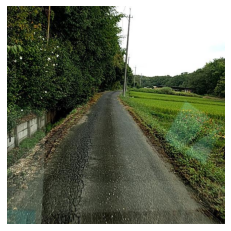

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000730.jpg
(600, 600)


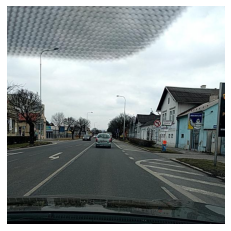

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002123.jpg
(600, 600)


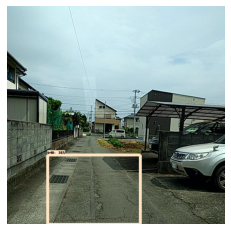

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_008258.jpg
(600, 600)


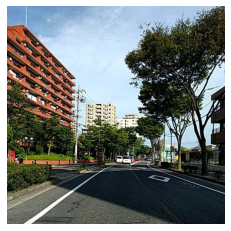

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_013088.jpg
(600, 600)


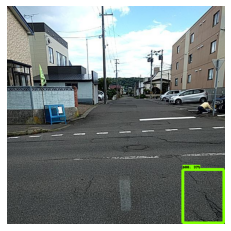

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_005327.jpg
(720, 720)


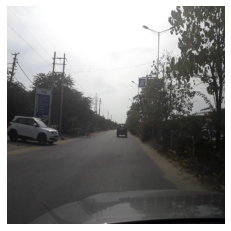

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_010252.jpg
(600, 600)


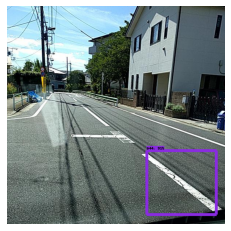

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_000026.jpg
(600, 600)


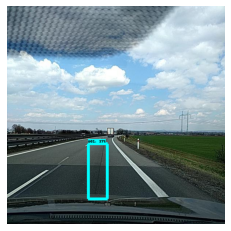

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_004152.jpg
(720, 720)


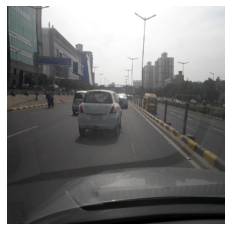

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_010877.jpg
(600, 600)


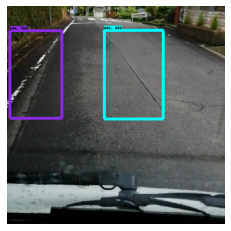

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003362.jpg
(600, 600)


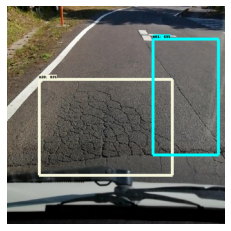

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_002758.jpg
(720, 720)


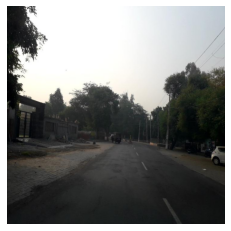

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_012414.jpg
(600, 600)


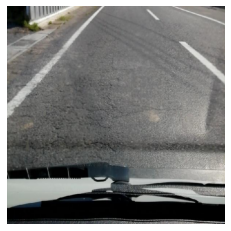

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_007329.jpg
(600, 600)


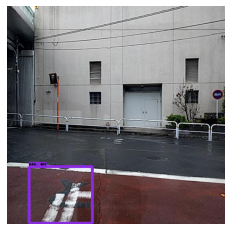

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_000174.jpg
(600, 600)


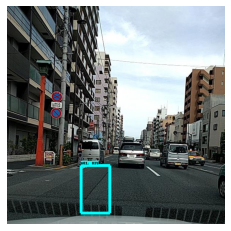

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_004010.jpg
(600, 600)


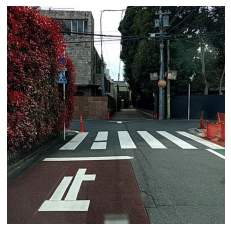

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009434.jpg
(600, 600)


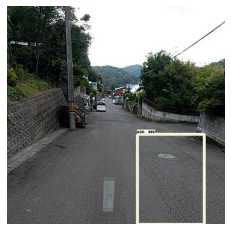

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003685.jpg
(1024, 1024)


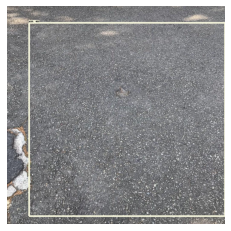

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_002982.jpg
(720, 720)


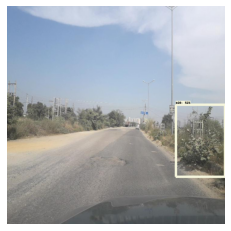

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_010832.jpg
(600, 600)


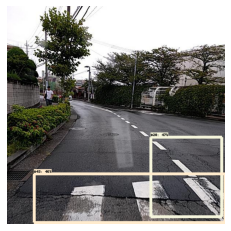

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_007695.jpg
(720, 720)


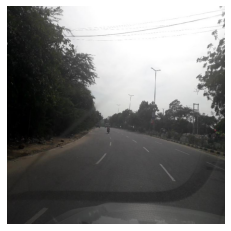

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009844.jpg
(720, 720)


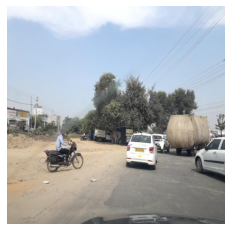

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_010152.jpg
(600, 600)


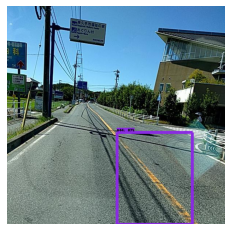

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_003420.jpg
(600, 600)


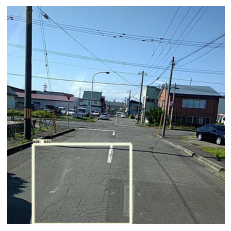

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_008506.jpg
(720, 720)


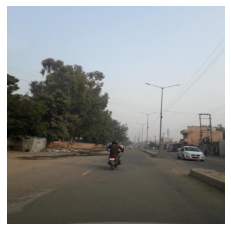

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_010688.jpg
(600, 600)


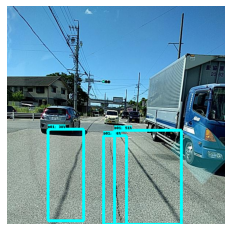

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_003924.jpg
(720, 720)


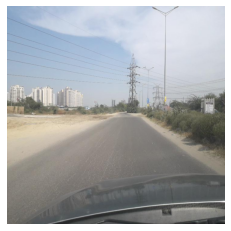

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_002057.jpg
(600, 600)


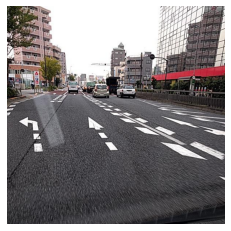

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_007300.jpg
(720, 720)


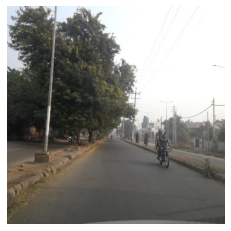

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/India_009431.jpg
(720, 720)


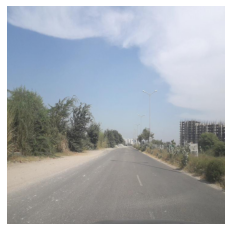

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_011998.jpg
(600, 600)


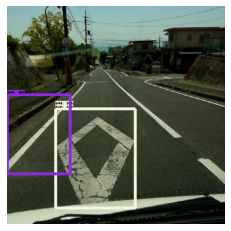

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_004419.jpg
(600, 600)


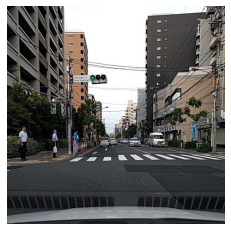

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_004505.jpg
(600, 600)


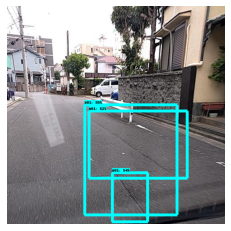

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_005175.jpg
(600, 600)


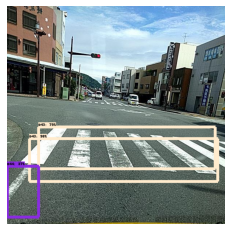

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_001210.jpg
(600, 600)


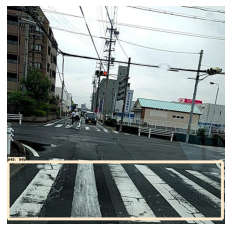

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Japan_009161.jpg
(600, 600)


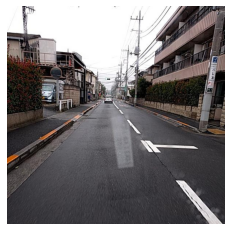

/home/facit/Desktop/Codes/Road Damage/RoadDamageDetector/test1/images/Czech_001265.jpg
(600, 600)


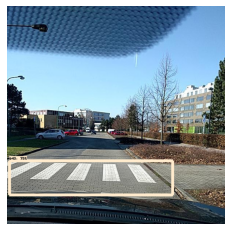

In [14]:
fig = plt.figure(figsize=(6,6))
with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        for image_path in images_test[1:200]:
            print(image_path)
            image = Image.open(image_path)
            # the array based representation of the image will be used later in order to prepare the
            # result image with boxes and labels on it.
            image_np = load_image_into_numpy_array(image)
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)
            # Actual detection.
            (boxes, scores, classes, num) = sess.run(
              [detection_boxes, detection_scores, detection_classes, num_detections],
              feed_dict={image_tensor: image_np_expanded})
            output_dict= {}
            output_dict["detection_boxes"] =boxes
            output_dict['detection_classes'] = classes
            output_dict['detection_scores'] = scores
            output_dict['num_detections'] = num
            output_dict=modify(output_dict)
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
              image_np,
                output_dict['detection_boxes'],output_dict['detection_classes'],output_dict['detection_scores'],
             category_index,
               min_score_thresh=0.35,
              use_normalized_coordinates=True,
              line_thickness=8)
            plt.axis('off')
            plt.imshow(image_np)
            show()
